# DCGAN for Lego Generation
The code for this this jupyter notebook was obtained
https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html

In [6]:
import os
import time
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from tqdm import tqdm
from IPython.display import HTML
from common import *

# Folder name for the saved models, plots, and videos
model_name = "gan_danbooru_64x64"
# Root directory for dataset
dataroot = "~/Documents/ML_Data/Danbooru2019_Portraits/"
# Start from a checkpoint?
#   Set to None if you want to start from scratch
#   Set to str of epoch number if you want to start from a checkpoint
checkpoint = ''

# -=-=-= DataLoader parameters =-=-=-
# If you want to augment the dataset
augment_dataset = False
# Number of workers for dataloader
workers = 32
# Batch size during training
batch_size = 128
# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# -=-=-= Model hyperparameters =-=-=-
# Number of channels in the training images. For color images this is 3
nc = 3
# Size of z latent vector (i.e. size of generator input)
nz = 100
# Size of feature maps in generator
ngf = 64
# Size of feature maps in discriminator
ndf = 64

# -=-=- Training parameters =-=-=-
# Number of training epochs
num_epochs = 50
# Save model every x epochs
save_every = 5
# Learning rate for optimizers
lr = 0.0002
# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5
# Number of GPUs available. Use 0 for CPU mode.
ngpu = 2
# Set random seed for reproducibility
manualSeed = 42
# manualSeed = random.randint(1, 10000) # use if you want new results

Using device:  cuda:0


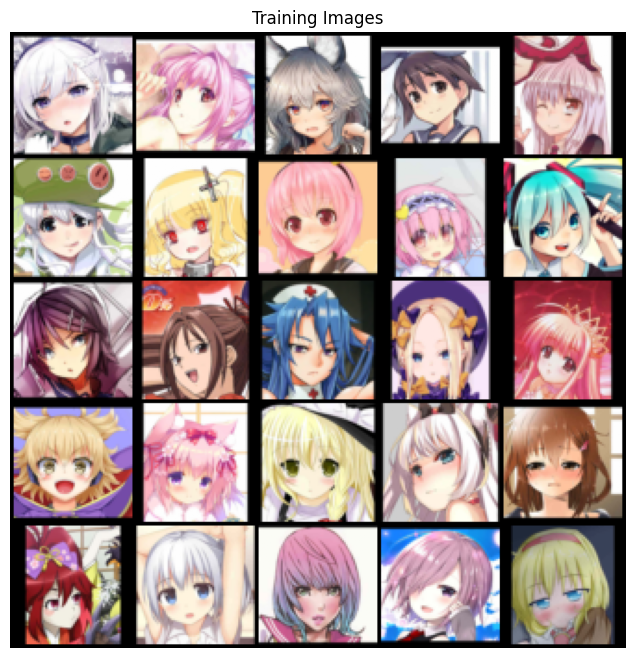

In [7]:
# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")
print("Using device: ", device)

# Set the seed
seed_everything(manualSeed)

# Make folder for saving models, plots, and videos
os.makedirs(f"./models/{model_name}", exist_ok=True)

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# We can use an image folder dataset the way we have it setup.
# Create the dataset and augmented dataset and the dataloader
dataset = load_data(dataroot, image_size, augment_dataset)
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)


# Plot some training images
images, _, _ = get_sample_images(dataloader, 25)
plot_grid(images, title="Training Images")

In [8]:

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

def weights(net, path=None):
    # Handle multi-GPU if desired
    if (device.type == 'cuda') and (ngpu > 1):
        net = nn.DataParallel(net, list(range(ngpu)))

    if checkpoint:
        net.load_state_dict(torch.load())
    else:
        # Apply the ``weights_init`` function to randomly initialize all weights
        #  to ``mean=0``, ``stdev=0.02``.
        # custom weights initialization called on ``netG`` and ``netD``
        def weights_init(m):
            classname = m.__class__.__name__
            if classname.find('Conv') != -1:
                nn.init.normal_(m.weight.data, 0.0, 0.02)
            elif classname.find('BatchNorm') != -1:
                nn.init.normal_(m.weight.data, 1.0, 0.02)
                nn.init.constant_(m.bias.data, 0)
        net.apply(weights_init)
    return net

In [9]:
# Create the models 
netG = Generator(ngpu).to(device)
netG = weights(netG, path=f"./models/{model_name}/netG-{checkpoint}.pt")
netD = Discriminator(ngpu).to(device)
netD = weights(netD, path=f"./models/{model_name}/netD-{checkpoint}.pt")

# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [10]:
# Training Loop
checkpoint_int = int(checkpoint)+1 if checkpoint else 0

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0
acc_list = []

print("Starting Training Loop...")
# For each epoch
s = time.perf_counter()
epochs = tqdm(range(checkpoint_int, num_epochs))
for epoch in epochs:
    num_correct = 0
    total_samples = 0
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate accuracy on all-real batch
        num_correct += torch.sum(torch.round(output) == label).item()
        total_samples += len(label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            # print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f\tAccuracy: %.4f'
            #       % (epoch, num_epochs, i, len(dataloader),
            #          errD.item(), errG.item(), D_x, D_G_z1, D_G_z2, num_correct/total_samples))
            epochs.set_description(f"Loss_D: {errD.item():.4f}, Loss_G: {errG.item():.4f}, D(x): {D_x:.4f}, D(G(z)): {D_G_z1:.4f} / {D_G_z2:.4f}, Accuracy: {num_correct/total_samples:.4f}")

        # Save Losses and Accuracy for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1
    acc_list.append(num_correct/total_samples)

    if epoch % save_every == 0 and not epoch == 0:
        # Save the models
        torch.save(netG.state_dict(), f'./models/{model_name}/netG-{epoch}.pt')
        torch.save(netD.state_dict(), f'./models/{model_name}/netD-{epoch}.pt')
torch.save(netG.state_dict(), f'./models/{model_name}/netG-{num_epochs}.pt')
torch.save(netD.state_dict(), f'./models/{model_name}/netD-{num_epochs}.pt')
e = time.perf_counter()
print(f"Time elapsed: {e-s} seconds")

Starting Training Loop...


Loss_D: 0.0078, Loss_G: 7.4854, D(x): 0.9945, D(G(z)): 0.0022 / 0.0020, Accuracy: 0.9833: 100%|██████████| 50/50 [1:46:58<00:00, 128.37s/it] 

Time elapsed: 6418.736252465023 seconds


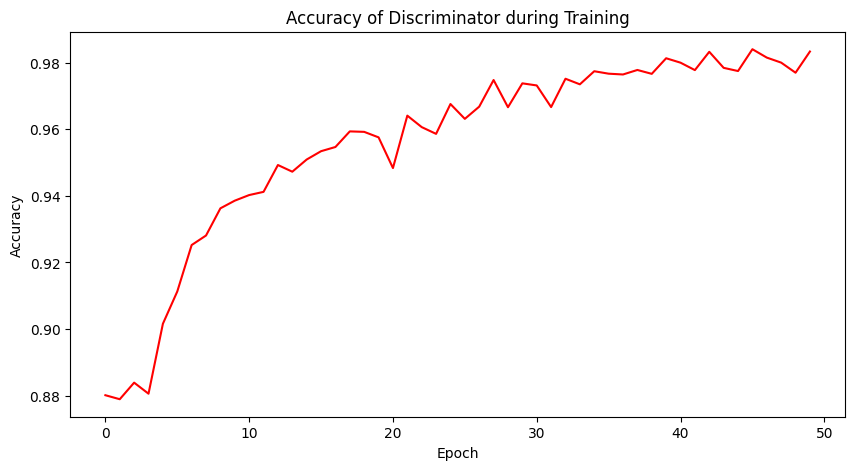

Final Accuracy:  0.9993094379022772


In [11]:
plt.figure(figsize=(10,5))
plt.title("Accuracy of Discriminator during Training")
plt.plot(acc_list, 'r-')
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.savefig(f"./models/{model_name}/accuracy-{num_epochs}.png")
plt.show()

num_correct = 0
total_samples = 0
for i, data in enumerate(dataloader, 0):
    real_cpu = data[0].to(device)
    b_size = real_cpu.size(0)
    label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
    output = netD(real_cpu).view(-1)
    num_correct += torch.sum(torch.round(output) == label).item()
    total_samples += len(label)
print("Final Accuracy: ", num_correct / total_samples)

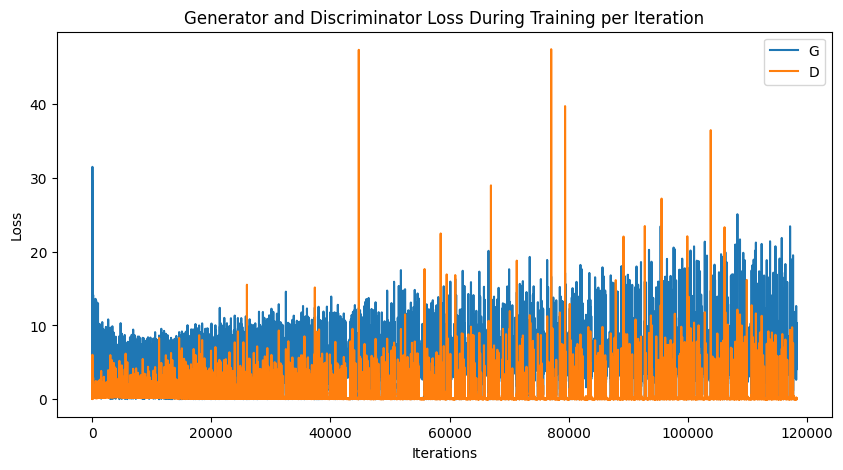

In [12]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training per Iteration")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend()
plt.savefig(f"./models/{model_name}/loss-iter-{num_epochs}.png")
plt.show()

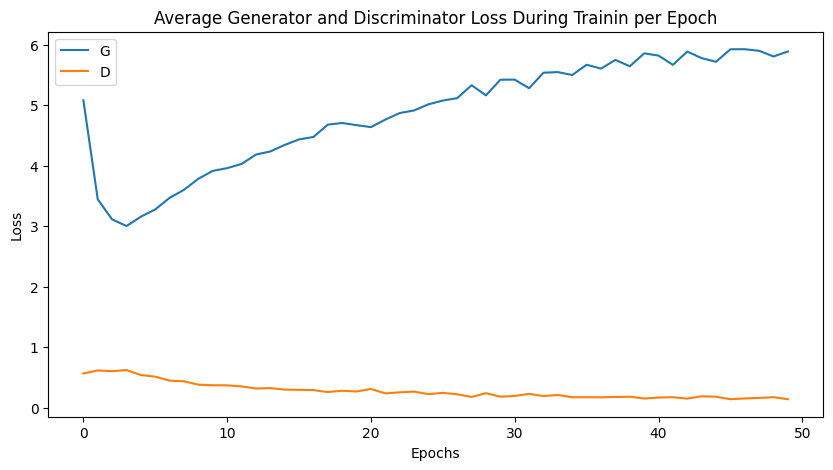

In [13]:
size_per_batch = int(np.ceil(len(dataloader.dataset)/batch_size))
plt.figure(figsize=(10,5))
plt.title("Average Generator and Discriminator Loss During Trainin per Epoch")
plt.plot(np.mean(np.array(G_losses).reshape(-1, size_per_batch), axis=1),label="G")
plt.plot(np.mean(np.array(D_losses).reshape(-1, size_per_batch), axis=1),label="D")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.savefig(f"./models/{model_name}/loss-epochs-{num_epochs}.png")
plt.show()

Animation size has reached 21183851 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


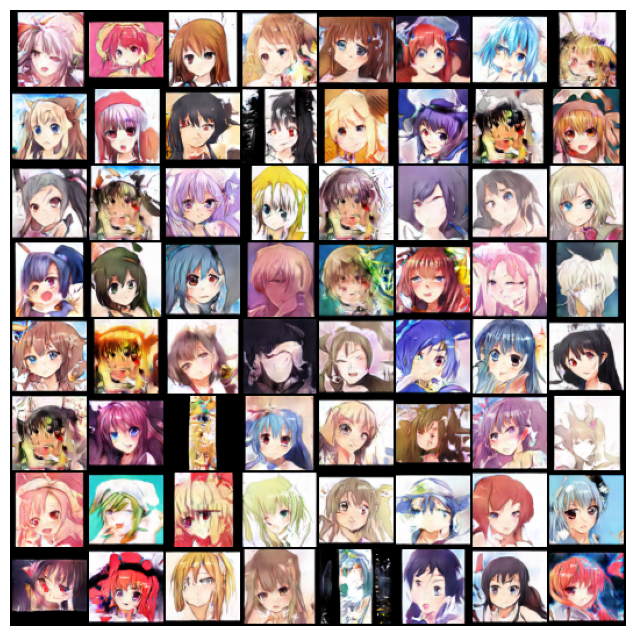

In [14]:
# Animation does not show up well on GitHub

# fig = plt.figure(figsize=(8,8))
# plt.axis("off")
# ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
# ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
# ani.save(f"./models/{model_name}/fixed_noise_images-{num_epochs}.mp4")

# HTML(ani.to_jshtml())

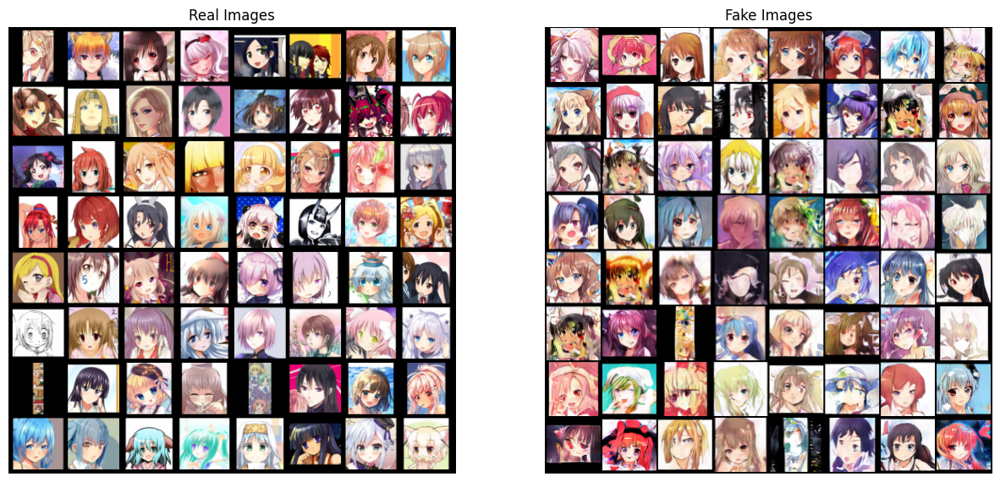

In [15]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

We can see that the DCGAN does much better than the VAE at generated anime faces, but they are not perfect.